In [2]:
from google.colab import drive
drive.mount('/content/gdrive',force_remount=True)

Mounted at /content/gdrive


In [3]:
import sqlite3
import re
import os
import shutil
import sys
import datetime
import csv
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd

In [ ]:
from IPython.core.display import clear_output
!pip install geopandas
!pip install dash
clear_output()

In [3]:
import geopandas as gpd

ModuleNotFoundError: ignored

In [4]:
db_connect = sqlite3.connect("/content/gdrive/MyDrive/dc2-policeuk.db") #path to database
cursor = db_connect.cursor()

#use "DATE(Month || '-01') BETWEEN '2019-01-01' AND '2020-01-01'" to select time range (inclusive range)
#database has dates stored as strings in Month column (disadvantage of python and sqlite3)
#concatenates '-01' to end of date strings to be able to parse as valid date string
#need to use DATE function for queries to read the strings as dates

query = """
    SELECT CrimeType, Month, LSOACode
    FROM Crime
    WHERE DATE(Month || '-01') BETWEEN '2015-01-01' AND '2021-12-01';
"""

df = pd.read_sql_query(query, db_connect)

cursor.close()
db_connect.close()

In [5]:
ladnm = pd.read_csv('/content/gdrive/MyDrive/lsoa_authority.csv') # csv with all the authorities and corresponding lsoas

In [6]:
def string_to_list(string, d):
  new_string = eval(string)[0]
  return [d+e for e in new_string.split(d) if e]

In [7]:
ladnm['lsoa11cd'] = ladnm['lsoa11cd'].map(lambda x:string_to_list(x,'E'))
area_dict = dict(zip(ladnm.ladnm, ladnm.lsoa11cd))

In [8]:
lsoa_to_authority = {} # creating a dictionary for mapping lsoa to local authority
for key, value in area_dict.items():
    for string in value:
        lsoa_to_authority.setdefault(string, []).append(key)

In [9]:
print('before deleting:',len(df))
df = df[df.LSOACode != '']
print('after deleting:',len(df))

before deleting: 7452647
after deleting: 7367241


In [10]:
def to_authority(lsoa):
  if lsoa in lsoa_to_authority.keys():
    return lsoa_to_authority[lsoa][0]
  return None

In [11]:
df['Local_authority'] = df['LSOACode'].map(lambda x:to_authority(x))

In [12]:
print('before deleting:',len(df))
df = df[df.Local_authority != None] # deleting the points with no local authority
print('after deleting:',len(df))

before deleting: 7367241
after deleting: 7367241


In [13]:
crimetypes = sorted(df['CrimeType'].unique())

In [14]:
#local_authorities = df.groupby(by=['Local_authority')
crimes = df.groupby(['Local_authority','CrimeType', 'Month']).size()
crimes

Local_authority       CrimeType                     Month  
Barking and Dagenham  Anti-social behaviour         2015-01     289
                                                    2015-02     287
                                                    2015-03     379
                                                    2015-04     442
                                                    2015-05     438
                                                               ... 
Westminster           Violence and sexual offences  2021-08    1018
                                                    2021-09     976
                                                    2021-10    1161
                                                    2021-11    1025
                                                    2021-12    1036
Length: 38799, dtype: int64

In [15]:
local = 'City of London'
Crimetype = 'Anti-social behaviour'
timeseries = crimes[local][Crimetype]
timeseries

Month
2015-01    89
2015-02    77
2015-03    80
2015-04    62
2015-05    73
           ..
2021-08    77
2021-09    97
2021-10    92
2021-11    75
2021-12    82
Length: 84, dtype: int64

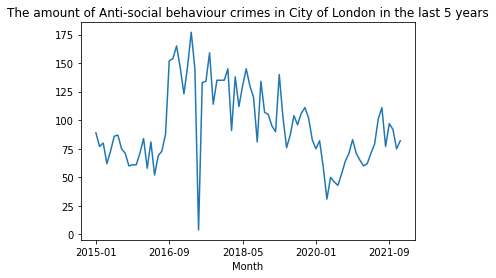

In [16]:
df_d=pd.pivot_table(df, index=['Month'], aggfunc='count')
timeseries.plot(title='The amount of '+Crimetype+' crimes in '+local+' in the last 5 years');

In [17]:
timeseries = timeseries.astype(float)
timeseries

Month
2015-01    89.0
2015-02    77.0
2015-03    80.0
2015-04    62.0
2015-05    73.0
           ... 
2021-08    77.0
2021-09    97.0
2021-10    92.0
2021-11    75.0
2021-12    82.0
Length: 84, dtype: float64

##Random forest

In [18]:
import pandas as pd
import numpy as np
%matplotlib inline

from sklearn.impute import SimpleImputer
from sklearn.ensemble import RandomForestRegressor

In [19]:
complete_df = pd.DataFrame({'count' : df.groupby(['Local_authority','Month','CrimeType']).size()}).reset_index()
complete_df

,Local_authority,Month,CrimeType,count
0,Barking and Dagenham,2015-01,Anti-social behaviour,289
1,Barking and Dagenham,2015-01,Bicycle theft,20
2,Barking and Dagenham,2015-01,Burglary,180
3,Barking and Dagenham,2015-01,Criminal damage and arson,116
4,Barking and Dagenham,2015-01,Drugs,76
...,...,...,...,...
38794,Westminster,2021-12,Robbery,267
38795,Westminster,2021-12,Shoplifting,283
38796,Westminster,2021-12,Theft from the person,1362
38797,Westminster,2021-12,Vehicle crime,373


In [20]:
nested_crimes = complete_df['Local_authority']+' '+complete_df['CrimeType']
nested_crimes

0            Barking and Dagenham Anti-social behaviour
1                    Barking and Dagenham Bicycle theft
2                         Barking and Dagenham Burglary
3        Barking and Dagenham Criminal damage and arson
4                            Barking and Dagenham Drugs
                              ...                      
38794                               Westminster Robbery
38795                           Westminster Shoplifting
38796                 Westminster Theft from the person
38797                         Westminster Vehicle crime
38798          Westminster Violence and sexual offences
Length: 38799, dtype: object

In [21]:
months = complete_df['Month'].unique()
nums = []
num = 1
for i in range(len(months)):
  if num < 12:
    nums.append(num)
    num += 1
  else:
    nums.append(num)
    num = 1


In [22]:
months = complete_df['Month'].unique()
#nums = np.arange(0,len(months))
month_encoder = {months[i]: nums[i] for i in range(len(months))}
complete_df['Month_of_year'] = complete_df['Month'].map(lambda x:month_encoder[x])

In [23]:
months = complete_df['Month'].unique()
nums = np.arange(0,len(months))
month_encoder = {months[i]: nums[i] for i in range(len(months))}
complete_df['Month'] = complete_df['Month'].map(lambda x:month_encoder[x])

In [24]:
crimetypes = complete_df['CrimeType'].unique()
nums = np.arange(1,len(crimetypes)+1)
crimetype_encoder = {crimetypes[i]: nums[i] for i in range(len(crimetypes))}

#complete_df['CrimeType'] = complete_df['CrimeType'].map(lambda x:crimetype_encoder[x])

complete_df['Crime_type'] = complete_df['CrimeType']
complete_df['CrimeType'] = nested_crimes # try out 


In [25]:
'''complete_df is for all authorities, but you can also choose a specific one'''

local = 'Barking and Dagenham'# choose local authority that you want to predict
df_local = complete_df[complete_df['Local_authority'] == local]
#melt = complete_df
melt = df_local.drop(['Local_authority'], axis=1)
melt # maybe include all the local authorities at once

,Month,CrimeType,count,Month_of_year,Crime_type
0,0,Barking and Dagenham Anti-social behaviour,289,1,Anti-social behaviour
1,0,Barking and Dagenham Bicycle theft,20,1,Bicycle theft
2,0,Barking and Dagenham Burglary,180,1,Burglary
3,0,Barking and Dagenham Criminal damage and arson,116,1,Criminal damage and arson
4,0,Barking and Dagenham Drugs,76,1,Drugs
...,...,...,...,...,...
1171,83,Barking and Dagenham Robbery,39,12,Robbery
1172,83,Barking and Dagenham Shoplifting,38,12,Shoplifting
1173,83,Barking and Dagenham Theft from the person,36,12,Theft from the person
1174,83,Barking and Dagenham Vehicle crime,209,12,Vehicle crime


In [26]:
melt = complete_df # try out

In [ ]:
# mask = dict(melt.groupby('CrimeType')['count'].mean() > 80) # only crimetypes that have more than 80 crimes
# melt = melt[melt['CrimeType'].map(lambda x:mask[x])]
# melt

In [27]:
split_point = 80 # temporal test train split
melt_train = melt[melt['Month'] < split_point].copy()
melt_valid = melt[melt['Month'] >= split_point].copy()

In [28]:
melt_train.head()

,Local_authority,Month,CrimeType,count,Month_of_year,Crime_type
0,Barking and Dagenham,0,Barking and Dagenham Anti-social behaviour,289,1,Anti-social behaviour
1,Barking and Dagenham,0,Barking and Dagenham Bicycle theft,20,1,Bicycle theft
2,Barking and Dagenham,0,Barking and Dagenham Burglary,180,1,Burglary
3,Barking and Dagenham,0,Barking and Dagenham Criminal damage and arson,116,1,Criminal damage and arson
4,Barking and Dagenham,0,Barking and Dagenham Drugs,76,1,Drugs


In [29]:
melt_train['crime_next_month'] = melt_train.groupby("CrimeType")['count'].shift(-1)
melt_valid['crime_next_month'] = melt_valid.groupby("CrimeType")['count'].shift(-1)

In [30]:
melt_train.tail()

,Local_authority,Month,CrimeType,count,Month_of_year,Crime_type,crime_next_month
38738,Westminster,79,Westminster Robbery,201,8,Robbery,NaN
38739,Westminster,79,Westminster Shoplifting,249,8,Shoplifting,NaN
38740,Westminster,79,Westminster Theft from the person,595,8,Theft from the person,NaN
38741,Westminster,79,Westminster Vehicle crime,290,8,Vehicle crime,NaN
38742,Westminster,79,Westminster Violence and sexual offences,1018,8,Violence and sexual offences,NaN


In [31]:
melt_train = melt_train.dropna()
melt_train.tail()

,Local_authority,Month,CrimeType,count,Month_of_year,Crime_type,crime_next_month
38724,Westminster,78,Westminster Robbery,211,7,Robbery,201.0
38725,Westminster,78,Westminster Shoplifting,222,7,Shoplifting,249.0
38726,Westminster,78,Westminster Theft from the person,626,7,Theft from the person,595.0
38727,Westminster,78,Westminster Vehicle crime,281,7,Vehicle crime,290.0
38728,Westminster,78,Westminster Violence and sexual offences,1005,7,Violence and sexual offences,1018.0


In [32]:
melt_train["lag_crimes_1"] = melt_train.groupby("CrimeType")['count'].shift(1)
melt_valid["lag_crimes_1"] = melt_valid.groupby("CrimeType")['count'].shift(1)

In [33]:
melt_train["diff_crimes_1"] = melt_train.groupby("CrimeType")['count'].diff(1)
melt_valid["diff_crimes_1"] = melt_valid.groupby("CrimeType")['count'].diff(1)

In [34]:
melt_train["mean_count_4"] = melt_train.groupby("CrimeType")['count'].rolling(4).mean().reset_index(level=0, drop=True)
melt_valid["mean_count_4"] = melt_valid.groupby("CrimeType")['count'].rolling(4).mean().reset_index(level=0, drop=True)

In [35]:
melt_train["mean_std_4"] = melt_train.groupby("CrimeType")['count'].rolling(4).mean().reset_index(level=0, drop=True)/melt_train.groupby("CrimeType")['count'].rolling(4).std().reset_index(level=0, drop=True)
melt_valid["mean_std_4"] = melt_valid.groupby("CrimeType")['count'].rolling(4).mean().reset_index(level=0, drop=True)/melt_valid.groupby("CrimeType")['count'].rolling(4).std().reset_index(level=0, drop=True)

melt_train["mean_std_8"] = melt_train.groupby("CrimeType")['count'].rolling(8).mean().reset_index(level=0, drop=True)/melt_train.groupby("CrimeType")['count'].rolling(8).std().reset_index(level=0, drop=True)
melt_valid["mean_std_8"] = melt_valid.groupby("CrimeType")['count'].rolling(8).mean().reset_index(level=0, drop=True)/melt_valid.groupby("CrimeType")['count'].rolling(8).std().reset_index(level=0, drop=True)

In [36]:
# evaluation metrices
# evalutaing per local authority!
def mape(y_true, y_pred):
    ape = np.abs((y_true - y_pred) / y_true)
    ape[~np.isfinite(ape)] = 0. # VERY questionable
    #ape[~np.isfinite(ape)] = 1. # pessimist estimate
    return np.mean(ape)

def wmape(y_true, y_pred):
    return np.sum(np.abs(y_true - y_pred)) / np.sum(np.abs(y_true))

def MASE(training_series, testing_series, prediction_series):
  """
  Computes the MEAN-ABSOLUTE SCALED ERROR forcast error for univariate time series prediction.
  
  See "Another look at measures of forecast accuracy", Rob J Hyndman
  
  parameters:
      training_series: the series used to train the model, 1d numpy array
      testing_series: the test series to predict, 1d numpy array or float
      prediction_series: the prediction of testing_series, 1d numpy array (same size as testing_series) or float
      absolute: "squares" to use sum of squares and root the result, "absolute" to use absolute values.
  
  """
  n = training_series.shape[0]
  d = np.abs(  np.diff( training_series) ).sum()/(n-1)
  
  errors = np.abs(testing_series - prediction_series )
  return errors.mean()/d

# find authorities with worst errors and try to find fixable pattern!

In [37]:
# baseline
y_pred = melt_train['count']
y_true = melt_train['crime_next_month']
print(mape(y_true, y_pred))
print(wmape(y_true, y_pred)) # timeseries split crossvalidation idea.


0.21434979637871715
0.1366587541297626


In [38]:
melt_train.head(5)

,Local_authority,Month,CrimeType,count,Month_of_year,Crime_type,crime_next_month,lag_crimes_1,diff_crimes_1,mean_count_4,mean_std_4,mean_std_8
0,Barking and Dagenham,0,Barking and Dagenham Anti-social behaviour,289,1,Anti-social behaviour,287.0,NaN,NaN,NaN,NaN,NaN
1,Barking and Dagenham,0,Barking and Dagenham Bicycle theft,20,1,Bicycle theft,11.0,NaN,NaN,NaN,NaN,NaN
2,Barking and Dagenham,0,Barking and Dagenham Burglary,180,1,Burglary,136.0,NaN,NaN,NaN,NaN,NaN
3,Barking and Dagenham,0,Barking and Dagenham Criminal damage and arson,116,1,Criminal damage and arson,114.0,NaN,NaN,NaN,NaN,NaN
4,Barking and Dagenham,0,Barking and Dagenham Drugs,76,1,Drugs,66.0,NaN,NaN,NaN,NaN,NaN


In [39]:
features = ['count', 
            'lag_crimes_1', 
            'diff_crimes_1', 
            'Month_of_year',
            'mean_std_4'] 
#'mean_count_4','mean_std_4' 'Month_of_year' More lags!     encode month of the year 1-12, rolling mean / rolling std
# after training, features

In [40]:
melt_train.replace([np.inf, -np.inf], np.nan, inplace=True) # try out

In [41]:
imputer = SimpleImputer()
Xtr = imputer.fit_transform(melt_train[features])
ytr = melt_train['crime_next_month']


mdl = RandomForestRegressor(n_estimators=1000, random_state=0, n_jobs=1) # n_jobs = 6?
mdl.fit(Xtr, ytr)



RandomForestRegressor(n_estimators=1000, n_jobs=1, random_state=0)

In [ ]:
 #{'bootstrap': True,
 #'max_depth': 70,
 #'max_features': 'auto',
 #'min_samples_leaf': 4,
 #'min_samples_split': 10,
 #'n_estimators': 2000}

  #{'max_depth': None,
 #'max_features': 'sqrt',
 #'min_samples_leaf': 1,
 #'min_samples_split': 2,
 #'n_estimators': 1800}

{'bootstrap': True,
 'max_depth': 10,
 'max_features': 'sqrt',
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'n_estimators': 2000}

In [ ]:
mdl2 = RandomForestRegressor(max_depth=70,max_features='sqrt', min_samples_split = 2, min_samples_leaf = 1,n_estimators=1800,n_jobs=1,random_state=0)
mdl2.fit(Xtr,ytr)

In [43]:
Xval = imputer.transform(melt_valid[features])
yval = melt_valid['crime_next_month']

p = mdl.predict(Xval)


In [44]:
p_1 = mdl2.predict(Xval)

In [ ]:
#mse = mean_squared_error(yval, p)


array([ 455.4486    ,   19.41171782,   94.08441667, ..., 1098.661     ,
        353.436     , 1120.483     ])

Fine tuning random forest

In [42]:
from sklearn.ensemble import RandomForestRegressor

mdl = RandomForestRegressor(n_estimators=1000, random_state=0, n_jobs=1)
from pprint import pprint
# Look at parameters used by our current forest
print('Parameters currently in use:\n')
pprint(mdl.get_params())

#These are all the parameters



Parameters currently in use:

{'bootstrap': True,
 'ccp_alpha': 0.0,
 'criterion': 'squared_error',
 'max_depth': None,
 'max_features': 'auto',
 'max_leaf_nodes': None,
 'max_samples': None,
 'min_impurity_decrease': 0.0,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'min_weight_fraction_leaf': 0.0,
 'n_estimators': 1000,
 'n_jobs': 1,
 'oob_score': False,
 'random_state': 0,
 'verbose': 0,
 'warm_start': False}


In [43]:
#Random Hyperparamter Grid

from sklearn.model_selection import RandomizedSearchCV
# Number of trees in random forest
n_estimators = [int(x) for x in np.linspace(start = 200, stop = 2000, num = 10)]
# Number of features to consider at every split
max_features = ['auto', 'sqrt']
# Maximum number of levels in tree
max_depth = [int(x) for x in np.linspace(10, 110, num = 11)]
max_depth.append(None)
# Minimum number of samples required to split a node
min_samples_split = [2, 6, 10]
# Minimum number of samples required at each leaf node
min_samples_leaf = [1, 3, 4]
# Method of selecting samples for training each tree
bootstrap = [True, False]
# Create the random grid
random_grid = {'n_estimators': n_estimators,
               'max_features': max_features,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf,
               'bootstrap': bootstrap}
print(random_grid)


{'n_estimators': [200, 400, 600, 800, 1000, 1200, 1400, 1600, 1800, 2000], 'max_features': ['auto', 'sqrt'], 'max_depth': [10, 20, 30, 40, 50, 60, 70, 80, 90, 100, 110, None], 'min_samples_split': [2, 6, 10], 'min_samples_leaf': [1, 3, 4], 'bootstrap': [True, False]}


In [44]:
#Random search Training

# Use the random grid to search for best hyperparameters
# First create the base model to tune
#mdl = RandomForestRegressor()
# Random search of parameters, using 3 fold cross validation, 
# search across 30 different combinations, and use all available cores
#rf_random = RandomizedSearchCV(estimator = mdl, param_distributions = random_grid, n_iter = 60, cv = 3, verbose=2, random_state=0,n_jobs=1) run this once
# Fit the random search model
#rf_random.fit(Xtr, ytr)

Fitting 3 folds for each of 60 candidates, totalling 180 fits
[CV] END bootstrap=True, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=10, n_estimators=400; total time=  16.8s
[CV] END bootstrap=True, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=10, n_estimators=400; total time=  14.6s
[CV] END bootstrap=True, max_depth=40, max_features=sqrt, min_samples_leaf=1, min_samples_split=10, n_estimators=400; total time=  14.3s
[CV] END bootstrap=True, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=1200; total time=  57.2s
[CV] END bootstrap=True, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=1200; total time=  55.9s
[CV] END bootstrap=True, max_depth=90, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=1200; total time=  55.3s
[CV] END bootstrap=False, max_depth=20, max_features=sqrt, min_samples_leaf=3, min_samples_split=6, n_estimators=200

RandomizedSearchCV(cv=3, estimator=RandomForestRegressor(), n_iter=60, n_jobs=1,
                   param_distributions={'bootstrap': [True, False],
                                        'max_depth': [10, 20, 30, 40, 50, 60,
                                                      70, 80, 90, 100, 110,
                                                      None],
                                        'max_features': ['auto', 'sqrt'],
                                        'min_samples_leaf': [1, 3, 4],
                                        'min_samples_split': [2, 6, 10],
                                        'n_estimators': [200, 400, 600, 800,
                                                         1000, 1200, 1400, 1600,
                                                         1800, 2000]},
                   random_state=0, verbose=2)

In [45]:
rf_random.best_params_ #Here you get the best paramters

{'bootstrap': True,
 'max_depth': None,
 'max_features': 'sqrt',
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'n_estimators': 1800}

In [45]:
mape(yval,p) # mape is lower without month of year?


0.15696670378115898

In [ ]:
wmape(yval,p)

0.13175090850106058

In [46]:
mape(yval,p_1)

0.1891705522533645

In [ ]:
wmape(yval,p_1)

0.12530162287510516

In [ ]:
p.shape

(1848,)

In [ ]:
melt_valid

,Local_authority,Month,CrimeType,count,Month_of_year,Crime_type,crime_next_month,lag_crimes_1,diff_crimes_1,mean_count_4,mean_std_4,mean_std_8
1120,Barking and Dagenham,80,Barking and Dagenham Anti-social behaviour,439,9,Anti-social behaviour,441.0,NaN,NaN,NaN,NaN,NaN
1121,Barking and Dagenham,80,Barking and Dagenham Bicycle theft,18,9,Bicycle theft,18.0,NaN,NaN,NaN,NaN,NaN
1122,Barking and Dagenham,80,Barking and Dagenham Burglary,81,9,Burglary,118.0,NaN,NaN,NaN,NaN,NaN
1123,Barking and Dagenham,80,Barking and Dagenham Criminal damage and arson,119,9,Criminal damage and arson,116.0,NaN,NaN,NaN,NaN,NaN
1124,Barking and Dagenham,80,Barking and Dagenham Drugs,116,9,Drugs,116.0,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
38794,Westminster,83,Westminster Robbery,267,12,Robbery,NaN,285.0,-18.0,264.00,12.282392,NaN
38795,Westminster,83,Westminster Shoplifting,283,12,Shoplifting,NaN,305.0,-22.0,285.50,14.401570,NaN
38796,Westminster,83,Westminster Theft from the person,1362,12,Theft from the person,NaN,1145.0,217.0,1033.25,3.262985,NaN
38797,Westminster,83,Westminster Vehicle crime,373,12,Vehicle crime,NaN,337.0,36.0,352.50,15.908102,NaN


In [ ]:
ape = np.abs((yval - p) / yval)
apes = np.array(ape.dropna()) # mape is 0.1 if you only take crimetypes with more than 80 crimes
apes.mean(axis=0)
apes.shape

(1386,)

In [ ]:
ape1 = np.abs((yval - p_1) / yval)
apes1 = np.array(ape1.dropna()) # mape is 0.1 if you only take crimetypes with more than 80 crimes
apes1.mean(axis=0)
apes1.shape

(1386,)

In [ ]:
violin_list = apes
violin_list

array([0.03276327, 0.07842877, 0.20267444, ..., 0.21666226, 0.00865505,
       0.10038127])

In [ ]:
violin_list1 = apes1
violin_list1

array([0.03261396, 0.93794052, 0.27893861, ..., 0.20653543, 0.05818594,
       0.06695437])

In [ ]:
import plotly.express as px

fig = px.violin(violin_list1, box=True,points='all')
fig.show()

In [ ]:
import plotly.express as px

fig = px.violin(violin_list, box=True,points='all')
fig.show()

In [ ]:
p

array([ 455.4486    ,   19.41171782,   94.08441667, ..., 1098.661     ,
        353.436     , 1120.483     ])

In [ ]:
As_beh = melt_train[melt_train['CrimeType'] == 5][['Month', 'count']]
As_beh = As_beh.set_index('Month')

In [ ]:
test_data = melt_valid[melt_valid['CrimeType'] == 5][['Month','count']]
test_data = test_data.set_index('Month')

In [ ]:
# test_predictions = pd.Series(p[:,4],index=test_data.index) # predicitions from crimetype 0 -> Anti social behaviour

In [ ]:
# test_predictions

In [ ]:
test_data

,count
Month,


In [ ]:
# import matplotlib.pyplot as plt
# import seaborn as sns
# %matplotlib inline
# ax = As_beh.plot()
# test_data.plot(ax=ax)
# test_predictions.plot(ax=ax)
# plt.title('Train, Test and Predicted Test using Random Forest');

In [ ]:
# product code = CrimeType
# week = Month
# sales = count
# sales_next_week = crime_next_month
# lag_sales_1 = lag_crimes_1
# diff_sales_1 = diff_crimes_1
# mean_sales_4 = mean_count_4
# sales_next_next_week = crime_next_next_month

##Extend to predicting multiple months

In [ ]:
melt_train['crime_next_next_month'] = melt_train.groupby("CrimeType")['count'].shift(-2)
melt_valid['crime_next_next_month'] = melt_valid.groupby("CrimeType")['count'].shift(-2)

In [ ]:
melt_train = melt_train.dropna(subset=['crime_next_month','crime_next_next_month'])

In [ ]:
imputer = SimpleImputer()
Xtr = imputer.fit_transform(melt_train[features])
ytr = melt_train[['crime_next_month', 'crime_next_next_month']]

mdl = RandomForestRegressor(n_estimators=1000, random_state=0, n_jobs=6)
mdl.fit(Xtr, ytr)

RandomForestRegressor(n_estimators=1000, n_jobs=6, random_state=0)

In [ ]:
Xval = imputer.transform(melt_valid[features])
yval = melt_valid[['crime_next_month', 'crime_next_next_month']]

p = mdl.predict(Xval)

In [ ]:
melt_valid

,Local_authority,Month,CrimeType,count,Month_of_year,Crime_type,crime_next_month,lag_crimes_1,diff_crimes_1,mean_count_4,mean_std_4,mean_std_8,crime_next_next_month
1120,Barking and Dagenham,80,Barking and Dagenham Anti-social behaviour,439,9,Anti-social behaviour,441.0,NaN,NaN,NaN,NaN,NaN,357.0
1121,Barking and Dagenham,80,Barking and Dagenham Bicycle theft,18,9,Bicycle theft,18.0,NaN,NaN,NaN,NaN,NaN,14.0
1122,Barking and Dagenham,80,Barking and Dagenham Burglary,81,9,Burglary,118.0,NaN,NaN,NaN,NaN,NaN,102.0
1123,Barking and Dagenham,80,Barking and Dagenham Criminal damage and arson,119,9,Criminal damage and arson,116.0,NaN,NaN,NaN,NaN,NaN,110.0
1124,Barking and Dagenham,80,Barking and Dagenham Drugs,116,9,Drugs,116.0,NaN,NaN,NaN,NaN,NaN,111.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
38794,Westminster,83,Westminster Robbery,267,12,Robbery,NaN,285.0,-18.0,264.00,12.282392,NaN,NaN
38795,Westminster,83,Westminster Shoplifting,283,12,Shoplifting,NaN,305.0,-22.0,285.50,14.401570,NaN,NaN
38796,Westminster,83,Westminster Theft from the person,1362,12,Theft from the person,NaN,1145.0,217.0,1033.25,3.262985,NaN,NaN
38797,Westminster,83,Westminster Vehicle crime,373,12,Vehicle crime,NaN,337.0,36.0,352.50,15.908102,NaN,NaN


In [ ]:
test = melt_valid.copy()
p_test = p[:,0]
p_test = p_test[np.array(~test['crime_next_month'].isnull())]
test = test[~test['crime_next_month'].isnull()]

In [ ]:
training_series = test['count']
testing_series = test['crime_next_month']
prediction_series = p_test

print(MASE(training_series, testing_series, prediction_series))

'''
When he have a MASE = 1, that means the model is exactly as good as just picking the last observation. An MASE = 0.5, 
means that our model has doubled the prediction accuracy. The lower, the better. When MASE > 1, that means the model needs a lot of improvement
'''

0.15230122546077887


'\nWhen he have a MASE = 1, that means the model is exactly as good as just picking the last observation. An MASE = 0.5, \nmeans that our model has doubled the prediction accuracy. The lower, the better. When MASE > 1, that means the model needs a lot of improvement\n'

In [ ]:
training_series = melt_valid['count']
testing_series = melt_valid['crime_next_month']
prediction_series = melt_valid['count']

MASE(training_series, testing_series, prediction_series)

0.140044123626053

##Generating new data

In [ ]:
melt_valid.tail()

,Local_authority,Month,CrimeType,count,Month_of_year,Crime_type,crime_next_month,lag_crimes_1,diff_crimes_1,mean_count_4,mean_std_4,mean_std_8,crime_next_next_month
38794,Westminster,83,Westminster Robbery,267,12,Robbery,NaN,285.0,-18.0,264.00,12.282392,NaN,NaN
38795,Westminster,83,Westminster Shoplifting,283,12,Shoplifting,NaN,305.0,-22.0,285.50,14.401570,NaN,NaN
38796,Westminster,83,Westminster Theft from the person,1362,12,Theft from the person,NaN,1145.0,217.0,1033.25,3.262985,NaN,NaN
38797,Westminster,83,Westminster Vehicle crime,373,12,Vehicle crime,NaN,337.0,36.0,352.50,15.908102,NaN,NaN
38798,Westminster,83,Westminster Violence and sexual offences,1036,12,Violence and sexual offences,NaN,1025.0,11.0,1049.50,13.322576,NaN,NaN


In [ ]:
new_examples = melt_valid[melt_valid['Month'] == 83].copy()
new_examples.head()

,Local_authority,Month,CrimeType,count,Month_of_year,Crime_type,crime_next_month,lag_crimes_1,diff_crimes_1,mean_count_4,mean_std_4,mean_std_8,crime_next_next_month
1162,Barking and Dagenham,83,Barking and Dagenham Anti-social behaviour,377,12,Anti-social behaviour,NaN,357.0,20.0,403.50,9.397284,NaN,NaN
1163,Barking and Dagenham,83,Barking and Dagenham Bicycle theft,9,12,Bicycle theft,NaN,14.0,-5.0,14.75,3.452714,NaN,NaN
1164,Barking and Dagenham,83,Barking and Dagenham Burglary,105,12,Burglary,NaN,102.0,3.0,101.50,6.621130,NaN,NaN
1165,Barking and Dagenham,83,Barking and Dagenham Criminal damage and arson,112,12,Criminal damage and arson,NaN,110.0,2.0,114.25,28.341937,NaN,NaN
1166,Barking and Dagenham,83,Barking and Dagenham Drugs,91,12,Drugs,NaN,111.0,-20.0,108.50,9.115823,NaN,NaN


In [ ]:
p = mdl.predict(new_examples[features])

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:444: UserWarning: X has feature names, but RandomForestRegressor was fitted without feature names
  f"X has feature names, but {self.__class__.__name__} was fitted without"


In [ ]:
new_examples['p_crimes_next_month'] = p[:, 0]
new_examples['p_crimes_next_next_month'] = p[:, 1]

In [ ]:
new_examples.head()

,Local_authority,Month,CrimeType,count,Month_of_year,Crime_type,crime_next_month,lag_crimes_1,diff_crimes_1,mean_count_4,mean_std_4,mean_std_8,crime_next_next_month,p_crimes_next_month,p_crimes_next_next_month
1162,Barking and Dagenham,83,Barking and Dagenham Anti-social behaviour,377,12,Anti-social behaviour,NaN,357.0,20.0,403.50,9.397284,NaN,NaN,348.388,339.040
1163,Barking and Dagenham,83,Barking and Dagenham Bicycle theft,9,12,Bicycle theft,NaN,14.0,-5.0,14.75,3.452714,NaN,NaN,10.901,11.179
1164,Barking and Dagenham,83,Barking and Dagenham Burglary,105,12,Burglary,NaN,102.0,3.0,101.50,6.621130,NaN,NaN,104.906,97.595
1165,Barking and Dagenham,83,Barking and Dagenham Criminal damage and arson,112,12,Criminal damage and arson,NaN,110.0,2.0,114.25,28.341937,NaN,NaN,102.921,94.024
1166,Barking and Dagenham,83,Barking and Dagenham Drugs,91,12,Drugs,NaN,111.0,-20.0,108.50,9.115823,NaN,NaN,102.014,109.300


In [ ]:
new_examples['next_month_difference'] = abs(new_examples['count'] - new_examples['p_crimes_next_month'])/new_examples['count'] 
new_examples.sort_values(by=['count','next_month_difference'])

,Local_authority,Month,CrimeType,count,Month_of_year,Crime_type,crime_next_month,lag_crimes_1,diff_crimes_1,mean_count_4,mean_std_4,mean_std_8,crime_next_next_month,p_crimes_next_month,p_crimes_next_next_month,next_month_difference
34088,Sutton,83,Sutton Possession of weapons,2,12,Possession of weapons,NaN,10.0,-8.0,7.75,1.618922,NaN,NaN,7.806000,7.185000,2.903000
8222,City of London,83,City of London Possession of weapons,3,12,Possession of weapons,NaN,7.0,-4.0,4.75,2.781315,NaN,NaN,7.286571,8.230000,1.428857
3515,Bexley,83,Bexley Bicycle theft,4,12,Bicycle theft,NaN,16.0,-12.0,13.00,2.146879,NaN,NaN,9.645000,8.229667,1.411250
23510,Kensington and Chelsea,83,Kensington and Chelsea Possession of weapons,5,12,Possession of weapons,NaN,6.0,-1.0,7.00,3.834058,NaN,NaN,6.614000,7.681533,0.322800
31736,Richmond upon Thames,83,Richmond upon Thames Possession of weapons,5,12,Possession of weapons,NaN,6.0,-1.0,4.50,3.485685,NaN,NaN,7.117000,7.684167,0.423400
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35257,Tower Hamlets,83,Tower Hamlets Anti-social behaviour,909,12,Anti-social behaviour,NaN,1076.0,-167.0,1171.50,4.972308,NaN,NaN,973.520000,933.514000,0.070979
38785,Westminster,83,Westminster Anti-social behaviour,978,12,Anti-social behaviour,NaN,1080.0,-102.0,1141.50,7.599593,NaN,NaN,1026.349000,1057.581000,0.049437
38798,Westminster,83,Westminster Violence and sexual offences,1036,12,Violence and sexual offences,NaN,1025.0,11.0,1049.50,13.322576,NaN,NaN,1089.050000,1031.147000,0.051207
38791,Westminster,83,Westminster Other theft,1360,12,Other theft,NaN,1358.0,2.0,1266.25,7.371029,NaN,NaN,1214.480000,1172.764000,0.107000


## Visualizations

In [ ]:
import plotly.express as px
from urllib.request import urlopen
import json

In [ ]:
authority = 'Kingston upon Thames' # these can both be changed with dropdowns
crimetype_filter = 'Anti-social behaviour'

In [ ]:
auth_df = df[df['Local_authority'] == authority] # df is the original dataframe
crime_auth = auth_df[auth_df['CrimeType'] == crimetype_filter]

with urlopen('https://opendata.arcgis.com/datasets/e9d10c36ebed4ff3865c4389c2c98827_0.geojson') as response:
    lsoas = json.load(response)

In [ ]:
all_months = auth_df['Month'].unique()
months = crime_auth.groupby(by=['Month','LSOACode']).size()
months = pd.DataFrame(months)

In [ ]:
months['month'] = [index[0] for index in months.index]
months['LSOA11CD'] = [index[1] for index in months.index]
months = months.set_index(np.arange(len(months))).rename(columns={0: "count"})

In [ ]:
all_months = all_months[-12:]
lsoas_in_auth = area_dict[authority]
lsoas_in_auth = pd.Series(lsoas_in_auth)

dataframes = []
for month in all_months:
  month_auth = months[months['month'] == month]
  frame = { 'count': pd.Series(np.zeros(len(lsoas_in_auth))), 'month': pd.Series([month for _ in range(len(lsoas_in_auth))]), 'LSOA11CD' : lsoas_in_auth }
  result = pd.DataFrame(frame)
  df_o = pd.concat([month_auth, result])
  criteria = df_o.LSOA11CD.isin((df_o.groupby('LSOA11CD').count() == 3).index) # edit this
  df_o = df_o[criteria].groupby('LSOA11CD')[['count']].sum()
  df_ou = df_o.copy()
  geo_df = gpd.GeoDataFrame.from_features(
    lsoas["features"]
  ).merge(df_ou, on='LSOA11CD').set_index('LSOA11CD')
  geo_df['month'] = [month for _ in range(len(geo_df))]
  dataframes.append(geo_df)

new_geo_df = pd.concat(dataframes)

In [ ]:
fig = px.choropleth(new_geo_df,
                   geojson=new_geo_df.geometry,
                   color_continuous_scale="reds",
                   locations=new_geo_df.index,
                   hover_name='LSOA11NM',
                   color="count",
                   projection="mercator",
                   animation_frame = 'month',
                   #range_color = [0,max(new_geo_df['count'])],
                   title = crimetype_filter+' in '+authority)
fig.update_geos(fitbounds="locations", visible=False)
fig.show()

In [ ]:
bar_df = new_examples[new_examples['Local_authority'] == authority][['Crime_type','count','p_crimes_next_month',	'p_crimes_next_next_month']]

In [ ]:
df1 = bar_df[['Crime_type','count']]
df1['month'] = ['December 2021' for _ in range(len(df1))]
df2 = bar_df[['Crime_type','p_crimes_next_month']].rename(columns={"p_crimes_next_month": "count"})
df2['month'] = ['January 2022' for _ in range(len(df1))]
df3 = bar_df[['Crime_type','p_crimes_next_next_month']].rename(columns={"p_crimes_next_next_month": "count"})
df3['month'] = ['February 2022' for _ in range(len(df1))]
bar_df = pd.concat([df1,df2,df3])

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
fig = px.bar(bar_df, x='month',color='Crime_type', y='count', title="Crime distribution in "+authority)
fig.show()

##Dashboard

In [ ]:
!pip install "dash-bootstrap-components<1"

     |████████████████████████████████| 197 kB 5.0 MB/s 


In [ ]:
import dash
import dash_bootstrap_components as dbc
#import dash_core_components as dcc
from dash import dcc
import dash_html_components as html
from dash.dependencies import Input, Output, State
import sqlite3
import pandas as pd
import plotly.express as px

/usr/local/lib/python3.7/dist-packages/dash_bootstrap_components/_table.py:5: UserWarning:


The dash_html_components package is deprecated. Please replace
`import dash_html_components as html` with `from dash import html`



#Interactive Graphs

In [ ]:
import ipywidgets as widgets

In [ ]:
local_authorities = df['Local_authority'].unique()
local_authorities = list(filter(None, local_authorities))
# local_authorities

crimetypes = sorted(df['CrimeType'].unique())
crimetypes_with_all = crimetypes
crimetypes_with_all.append("All crimes")
# crimetypes_with_all.sort()
crimetypes_with_all

local_authorities = df['Local_authority'].unique()
local_authorities_with_all = local_authorities.tolist()
local_authorities_with_all.append("All authorities in GLA")
# local_authorities_with_all.sort()
local_authorities_with_all

['Camden',
 'City of London',
 'Hammersmith and Fulham',
 'Islington',
 'Tower Hamlets',
 'Westminster',
 'Barking and Dagenham',
 'Barnet',
 None,
 'Bexley',
 'Brent',
 'Bromley',
 'Croydon',
 'Ealing',
 'Enfield',
 'Greenwich',
 'Hackney',
 'Haringey',
 'Harrow',
 'Havering',
 'Hillingdon',
 'Hounslow',
 'Kensington and Chelsea',
 'Kingston upon Thames',
 'Lambeth',
 'Lewisham',
 'Merton',
 'Newham',
 'Redbridge',
 'Richmond upon Thames',
 'Southwark',
 'Sutton',
 'Waltham Forest',
 'Wandsworth',
 'All authorities in GLA']

In [ ]:
def timeseries_plot(Crimetype, local):
    """
    Show the Timeseries plot with dropdown for location and crimetype
    """
    if Crimetype == "All crimes":
      timeseries = crimes[local]
    elif local == "All authorities in GLA":
      timeseries = crimes[Crimetype]
    elif ((Crimetype == "All crimes") and (local == "All authorities in GLA")):
      timeseries = crimes
    else:
      timeseries = crimes[local][Crimetype]
    timeseries.plot(title='The amount of '+Crimetype+' crimes in '+local+' in the last 5 years');
     
widgets.interact(timeseries_plot, Crimetype=crimetypes, local =local_authorities_with_all);

interactive(children=(Dropdown(description='Crimetype', options=('Anti-social behaviour', 'Bicycle theft', 'Bu…

In [ ]:
fig = px.choropleth(new_geo_df,
                   geojson=new_geo_df.geometry,
                   color_continuous_scale="reds",
                   locations=new_geo_df.index,
                   hover_name='LSOA11NM',
                   color="count",
                   projection="mercator",
                   animation_frame = 'month',
                   #range_color = [0,max(new_geo_df['count'])],
                   title = crimetype_filter+' in '+authority)
fig.update_geos(fitbounds="locations", visible=False)
fig.show()

In [ ]:
crimetypes = sorted(df['CrimeType'].unique())
crimetypes_with_all = crimetypes
crimetypes_with_all.append("All crimes")
crimetypes_with_all.sort()
crimetypes_with_all

['All crimes',
 'Anti-social behaviour',
 'Bicycle theft',
 'Burglary',
 'Criminal damage and arson',
 'Drugs',
 'Other crime',
 'Other theft',
 'Possession of weapons',
 'Public order',
 'Robbery',
 'Shoplifting',
 'Theft from the person',
 'Vehicle crime',
 'Violence and sexual offences']

In [ ]:
def chloropleth_interactive(authority, crimetype_filter):
    """
    Show the chloropleth plot with dropdown for location and crimetype
    """


    if authority == "All authorities in GLA":
      auth_df = df # df is the original dataframe
      if crimetype_filter == "All crimes":
       crime_auth = auth_df
      else:
        crime_auth = auth_df[auth_df['CrimeType'] == crimetype_filter]
      
      with urlopen('https://opendata.arcgis.com/datasets/e9d10c36ebed4ff3865c4389c2c98827_0.geojson') as response:
        lsoas = json.load(response)
      
      all_months = auth_df['Month'].unique()
      months = crime_auth.groupby(by=['Month','LSOACode']).size()
      months = pd.DataFrame(months)
      months['month'] = [index[0] for index in months.index]
      months['LSOA11CD'] = [index[1] for index in months.index]
      months = months.set_index(np.arange(len(months))).rename(columns={0: "count"})
      all_months = all_months[-12:]
      lijst = list(area_dict.values())
      lsoas_in_auth = list(np.concatenate(lijst).flat)
      lsoas_in_auth = pd.Series(lsoas_in_auth) # change this to series of all lsoas to get the complete greater london map

      dataframes = []
      for month in all_months:
        month_auth = months[months['month'] == month]
        frame = { 'count': pd.Series(np.zeros(len(lsoas_in_auth))), 'month': pd.Series([month for _ in range(len(lsoas_in_auth))]), 'LSOA11CD' : lsoas_in_auth }
        result = pd.DataFrame(frame)
        df_o = pd.concat([month_auth, result])
        criteria = df_o.LSOA11CD.isin((df_o.groupby('LSOA11CD').count() == 3).index) # edit this
        df_o = df_o[criteria].groupby('LSOA11CD')[['count']].sum()
        df_ou = df_o.copy()
        geo_df = gpd.GeoDataFrame.from_features(
          lsoas["features"]
        ).merge(df_ou, on='LSOA11CD').set_index('LSOA11CD')
        geo_df['month'] = [month for _ in range(len(geo_df))]
        dataframes.append(geo_df)

      new_geo_df = pd.concat(dataframes)

      fig = px.choropleth(new_geo_df,
                    geojson=new_geo_df.geometry,
                    color_continuous_scale="reds",
                    locations=new_geo_df.index,
                    hover_name='LSOA11NM',
                    color="count",
                    projection="mercator",
                    animation_frame = 'month',
                    #range_color = [0,max(new_geo_df['count'])],
                    title = crimetype_filter+' in '+authority)
      fig.update_geos(fitbounds="locations", visible=False)
      fig.show()


      
    else:
      auth_df = df[df['Local_authority'] == authority] # df is the original dataframe

      if crimetype_filter == "All crimes":
       crime_auth = auth_df
      else:
        crime_auth = auth_df[auth_df['CrimeType'] == crimetype_filter]

      with urlopen('https://opendata.arcgis.com/datasets/e9d10c36ebed4ff3865c4389c2c98827_0.geojson') as response:
        lsoas = json.load(response)
    
    all_months = auth_df['Month'].unique()
    months = crime_auth.groupby(by=['Month','LSOACode']).size()
    months = pd.DataFrame(months)
    months['month'] = [index[0] for index in months.index]
    months['LSOA11CD'] = [index[1] for index in months.index]
    months = months.set_index(np.arange(len(months))).rename(columns={0: "count"})
    all_months = all_months[-12:]
    lsoas_in_auth = area_dict[authority] 
    lsoas_in_auth = pd.Series(lsoas_in_auth) # change this to series of all lsoas to get the complete greater london map

    dataframes = []
    for month in all_months:
      month_auth = months[months['month'] == month]
      frame = { 'count': pd.Series(np.zeros(len(lsoas_in_auth))), 'month': pd.Series([month for _ in range(len(lsoas_in_auth))]), 'LSOA11CD' : lsoas_in_auth }
      result = pd.DataFrame(frame)
      df_o = pd.concat([month_auth, result])
      criteria = df_o.LSOA11CD.isin((df_o.groupby('LSOA11CD').count() == 3).index) # edit this
      df_o = df_o[criteria].groupby('LSOA11CD')[['count']].sum()
      df_ou = df_o.copy()
      geo_df = gpd.GeoDataFrame.from_features(
        lsoas["features"]
      ).merge(df_ou, on='LSOA11CD').set_index('LSOA11CD')
      geo_df['month'] = [month for _ in range(len(geo_df))]
      dataframes.append(geo_df)

    new_geo_df = pd.concat(dataframes)

    fig = px.choropleth(new_geo_df,
                   geojson=new_geo_df.geometry,
                   color_continuous_scale="reds",
                   locations=new_geo_df.index,
                   hover_name='LSOA11NM',
                   color="count",
                   projection="mercator",
                   animation_frame = 'month',
                   #range_color = [0,max(new_geo_df['count'])],
                   title = crimetype_filter+' in '+authority)
    fig.update_geos(fitbounds="locations", visible=False)
    fig.show()

    
    


   

widgets.interact(chloropleth_interactive, crimetype_filter=crimetypes_with_all, authority =local_authorities_with_all);


In [ ]:
crimetypes = sorted(df['CrimeType'].unique())
crimetypes_with_all = crimetypes
crimetypes_with_all.append("All crimes")
crimetypes_with_all

['Anti-social behaviour',
 'Bicycle theft',
 'Burglary',
 'Criminal damage and arson',
 'Drugs',
 'Other crime',
 'Other theft',
 'Possession of weapons',
 'Public order',
 'Robbery',
 'Shoplifting',
 'Theft from the person',
 'Vehicle crime',
 'Violence and sexual offences',
 'All crimes']

In [ ]:
def stacked_interactive(authority):
  bar_df = new_examples[new_examples['Local_authority'] == authority][['Crime_type','count','p_crimes_next_month',	'p_crimes_next_next_month']]
  df1 = bar_df[['Crime_type','count']]
  df1['month'] = ['December 2021' for _ in range(len(df1))]
  df2 = bar_df[['Crime_type','p_crimes_next_month']].rename(columns={"p_crimes_next_month": "count"})
  df2['month'] = ['January 2022' for _ in range(len(df1))]
  df3 = bar_df[['Crime_type','p_crimes_next_next_month']].rename(columns={"p_crimes_next_next_month": "count"})
  df3['month'] = ['February 2022' for _ in range(len(df1))]
  bar_df = pd.concat([df1,df2,df3])
  fig = px.bar(bar_df, x='month',color='Crime_type', y='count', title="Crime distribution in "+authority)
  fig.show()

# stacked_interactive("Camden")



In [ ]:
widgets.interact(chloropleth_interactive, crimetype_filter=crimetypes_with_all, authority =local_authorities_with_all);
widgets.interact(timeseries_plot, Crimetype=crimetypes, local =local_authorities);
widgets.interact(stacked_interactive, authority = local_authorities);


interactive(children=(Dropdown(description='authority', options=('Camden', 'City of London', 'Hammersmith and …

interactive(children=(Dropdown(description='Crimetype', options=('Anti-social behaviour', 'Bicycle theft', 'Bu…

interactive(children=(Dropdown(description='authority', options=('Camden', 'City of London', 'Hammersmith and …